<a href="https://colab.research.google.com/github/delschadj/MachineLearning/blob/main/boston_house_price_prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Boston house price prediction

The problem that we are going to solve here is that given a set of features that describe a house in Boston, our machine learning model must predict the house price. To train our machine learning model with boston housing data, we will be using scikit-learn’s boston dataset.

In [ ]:
# Importing the libraries 
import pandas as pd
import numpy as np
from sklearn import metrics
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.datasets import load_boston

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

%matplotlib inline

# 1. Analyzing Data

### Initializing the dataframe

In [ ]:
boston = load_boston()

df = pd.DataFrame(boston.data)
df.columns = boston.feature_names
df['PRICE'] = boston.target 

X = df.drop(['PRICE'], axis = 1)
y = df['PRICE']

### Overview of data

In [ ]:
df.head()

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,PRICE
0,0.00632,18.0,2.31,0.0,0.538,6.575,65.2,4.0900,1.0,296.0,15.3,396.90,4.98,24.0
1,0.02731,0.0,7.07,0.0,0.469,6.421,78.9,4.9671,2.0,242.0,17.8,396.90,9.14,21.6
2,0.02729,0.0,7.07,0.0,0.469,7.185,61.1,4.9671,2.0,242.0,17.8,392.83,4.03,34.7
3,0.03237,0.0,2.18,0.0,0.458,6.998,45.8,6.0622,3.0,222.0,18.7,394.63,2.94,33.4
4,0.06905,0.0,2.18,0.0,0.458,7.147,54.2,6.0622,3.0,222.0,18.7,396.90,5.33,36.2


## Attributes
There are 13 attributes. These attributes are the columns of the data set. The price column is not included in the dataset.

1. CRIM per capita crime rate by town <br>
2. ZN proportion of residential land zoned for lots over 25,000 sq.ft. <br>
3. INDUS proportion of non-retail business acres per town <br>
4. CHAS Charles River dummy variable (= 1 if tract bounds river; 0 otherwise) <br>
5. NOX nitric oxides concentration (parts per 10 million) <br>
6. RM average number of rooms per dwelling <br>
7. AGE proportion of owner-occupied units built prior to 1940 <br>
8. DIS weighted distances to five Boston employment centres <br>
9. RAD index of accessibility to radial highways <br>
10. TAX full-value property-tax rate per 10,000usd <br>
11. PTRATIO pupil-teacher ratio by town <br>
12. B 1000(Bk - 0.63)^2 where Bk is the proportion of blacks by town <br>
13. LSTAT % lower status of the population <br>

In [ ]:
df.describe()

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,PRICE
count,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000
mean,3.613524,11.363636,11.136779,0.069170,0.554695,6.284634,68.574901,3.795043,9.549407,408.237154,18.455534,356.674032,12.653063,22.532806
std,8.601545,23.322453,6.860353,0.253994,0.115878,0.702617,28.148861,2.105710,8.707259,168.537116,2.164946,91.294864,7.141062,9.197104
min,0.006320,0.000000,0.460000,0.000000,0.385000,3.561000,2.900000,1.129600,1.000000,187.000000,12.600000,0.320000,1.730000,5.000000
25%,0.082045,0.000000,5.190000,0.000000,0.449000,5.885500,45.025000,2.100175,4.000000,279.000000,17.400000,375.377500,6.950000,17.025000
50%,0.256510,0.000000,9.690000,0.000000,0.538000,6.208500,77.500000,3.207450,5.000000,330.000000,19.050000,391.440000,11.360000,21.200000
75%,3.677083,12.500000,18.100000,0.000000,0.624000,6.623500,94.075000,5.188425,24.000000,666.000000,20.200000,396.225000,16.955000,25.000000
max,88.976200,100.000000,27.740000,1.000000,0.871000,8.780000,100.000000,12.126500,24.000000,711.000000,22.000000,396.900000,37.970000,50.000000


### Correlations

<AxesSubplot:>

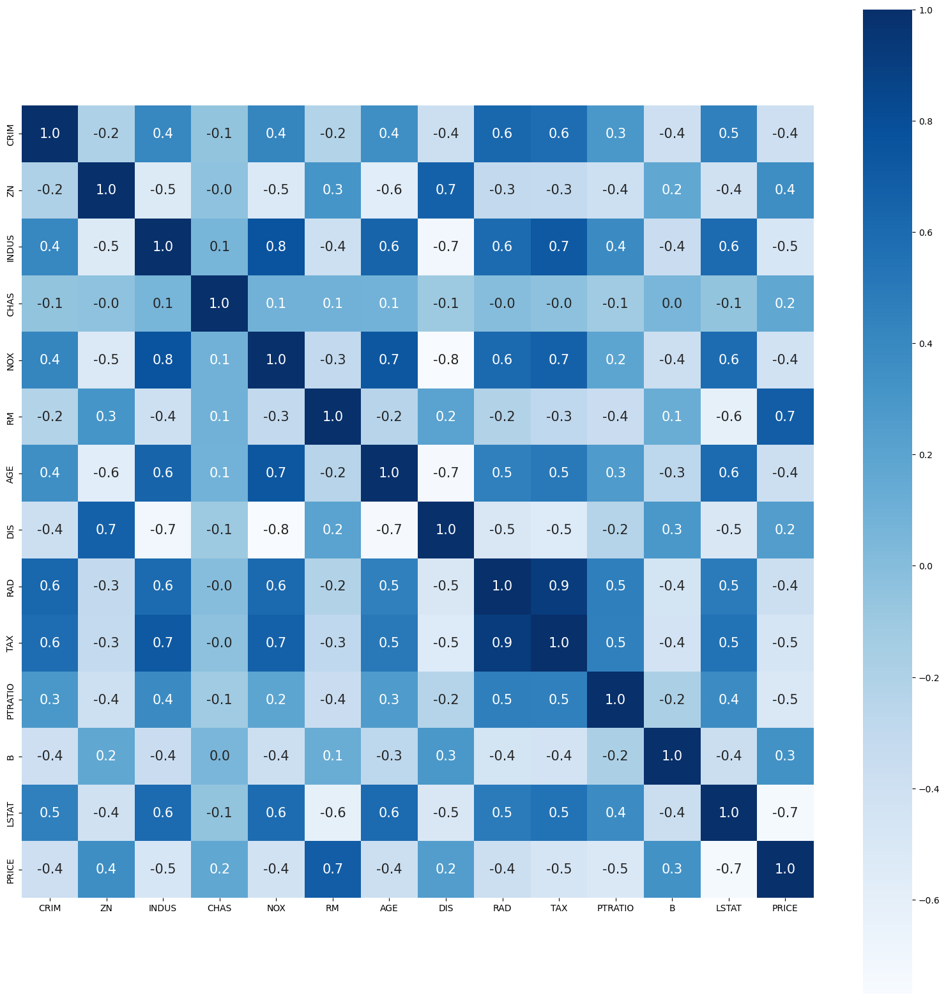

In [ ]:
corr = df.corr()
plt.figure(figsize=(20,20))
sns.heatmap(corr, cbar=True, square= True, fmt='.1f', annot=True, annot_kws={'size':15}, cmap='Blues')

# 2. Preparing data / Evaluation

## Checking for missing values

In [ ]:
df.isnull().sum()
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 506 entries, 0 to 505
Data columns (total 14 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   CRIM     506 non-null    float64
 1   ZN       506 non-null    float64
 2   INDUS    506 non-null    float64
 3   CHAS     506 non-null    float64
 4   NOX      506 non-null    float64
 5   RM       506 non-null    float64
 6   AGE      506 non-null    float64
 7   DIS      506 non-null    float64
 8   RAD      506 non-null    float64
 9   TAX      506 non-null    float64
 10  PTRATIO  506 non-null    float64
 11  B        506 non-null    float64
 12  LSTAT    506 non-null    float64
 13  PRICE    506 non-null    float64
dtypes: float64(14)
memory usage: 55.5 KB


## Evaluation functions

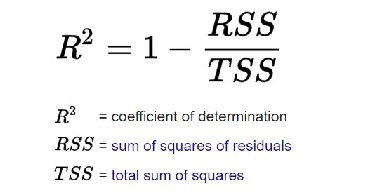

### R^2 Score

In [ ]:
def r2score(y_pred, y):
    rss = np.sum((y_pred - y) ** 2)
    tss = np.sum((y-y.mean()) ** 2)
    
    r2 = 1 - (rss / tss)
    return r2

### Mean Squared Error (MSE)

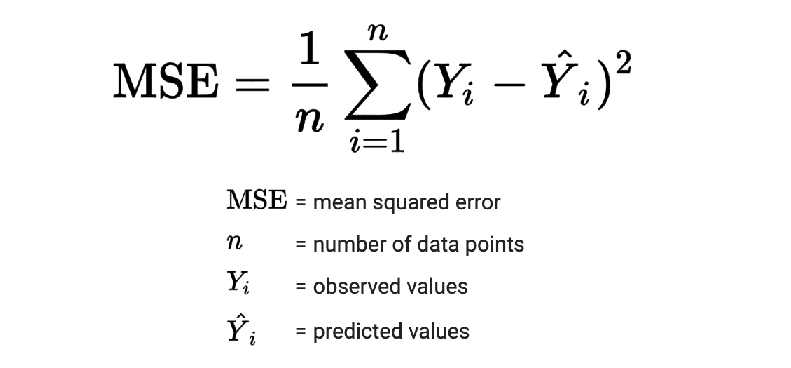

In [ ]:
def mse(y_pred, y):
    totalSum = np.sum((y_pred - y) ** 2)
    
    mse = (1/len(y)) * totalSum
    
    return mse

# 2. Training models

## A - Linear Regression from Scratch

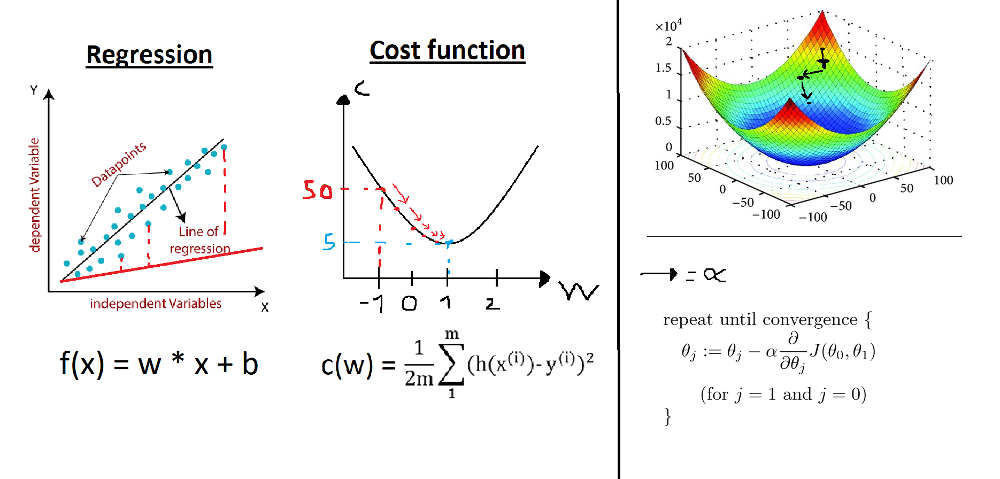

### Splitting into training and test data

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.33, random_state = 5)                                            # Standardizing Data 

### Z-Score Standardization

In [ ]:
# X_standardized = X - μ / σ
X_train_standardized = (X_train - X_train .mean()) / X_train.std()
X_test_standardized  = (X_test - X_train.mean()) /  X_train.std()

### Cost function

In [ ]:
def cost_function(X, y, w, b):
    cost = np.sum((((X.dot(w) + b) - y) ** 2) / (2*len(y)))
    return cost

### Gradient decent

In [ ]:
def gradient_descent_function(X, y, w, b, alpha=0.01, iteration=1000):
    m = len(y)
    costs = [0] * iteration
    
    for epoch in range(iteration):
        # Regression prediction
        f_wb = X.dot(w) + b
        
        # Calculate error
        error = f_wb - y
        
        # Calculate gradient descent
        gradientW = X.T.dot(error) / m
        gradientB = np.sum(error) / m
        
        # Update weights and bias
        w = w - alpha*gradientW
        b = b - alpha*gradientB
        
        # Store current lost
        cost = cost_function(X, y, w, b)
        costs[epoch] = cost
        
    return w, b, costs

In [ ]:
# Initial weights + bias
w = np.random.randn(X_train.shape[1])
b = 0

weights, bias, costs = gradient_descent_function(X_train_standardized, y_train, w, b, iteration=2500);

### Visualizing cost function

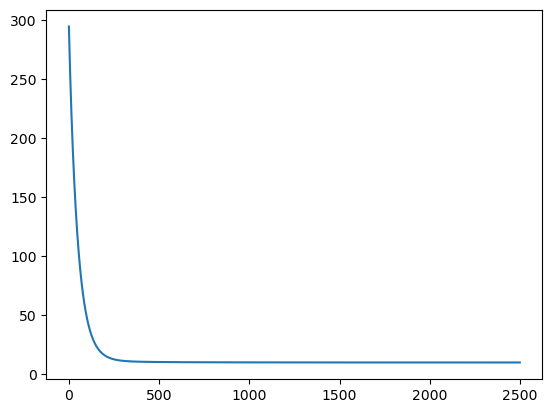

CRIM      -1.290249
ZN         0.831176
INDUS     -0.256880
CHAS       0.201595
NOX       -1.434763
RM         2.816892
AGE       -0.350348
DIS       -2.761284
RAD        2.676122
TAX       -1.962566
PTRATIO   -2.120527
B          1.052550
LSTAT     -3.334673
dtype: float64

In [ ]:
plt.plot (costs)
plt.show()
weights

### Final model

In [ ]:
def predict (X,w,b):
    return X.dot(w) + b

### Model Evaluation

#### On training data

In [ ]:
y_pred_train = predict (X_train_standardized, weights, bias)

In [ ]:
pred_df = pd.DataFrame(
    {
        'Actual Value' : y_train, 
     'Predicted Values' : y_pred_train,
    }
)
pred_df.head(10)

,Actual Value,Predicted Values
435,13.4,13.190013
88,23.6,30.495070
365,27.5,13.436652
242,22.2,24.249469
461,17.7,20.567486
129,14.3,13.577862
12,21.7,21.760049
419,8.4,14.340287
152,15.3,18.822203
79,20.3,22.189780


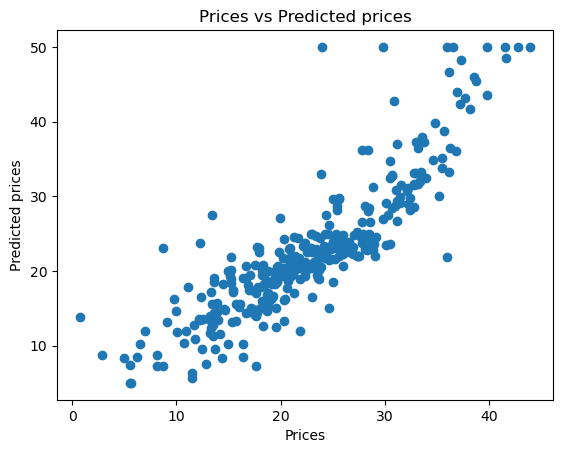

In [ ]:
# Visualizing the differences between actual prices and predicted values
plt.scatter(y_pred_train, y_train)
plt.xlabel("Prices")
plt.ylabel("Predicted prices")
plt.title("Prices vs Predicted prices")
plt.show()

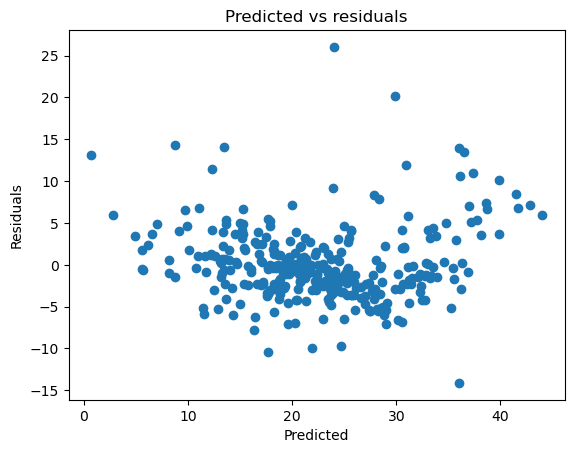

In [ ]:
# Checking residuals
plt.scatter(y_pred_train,y_train-y_pred_train)
plt.title("Predicted vs residuals")
plt.xlabel("Predicted")
plt.ylabel("Residuals")
plt.show()

In [ ]:
# Model Evaluation
print('R^2 Score:', r2score (y_pred_train, y_train))
print('Mean Squared Error:', mse (y_pred_train, y_train))

R^2 Score: 0.7549860379799425
Mean Squared Error: 19.558511766646777


#### On test data

In [ ]:
y_pred_test = predict(X_test_standardized, weights, bias)

In [ ]:
pred_df = pd.DataFrame(
    {
        'Actual Value' : y_test, 
     'Predicted Values' : y_pred_test,
    }
)
pred_df.head(10)

,Actual Value,Predicted Values
226,37.6,37.402197
292,27.9,31.243161
90,22.6,27.197075
373,13.8,6.383740
273,35.2,33.609839
417,10.4,5.674050
503,23.9,27.094337
234,29.0,29.896896
111,22.8,26.529196
472,23.2,22.370006


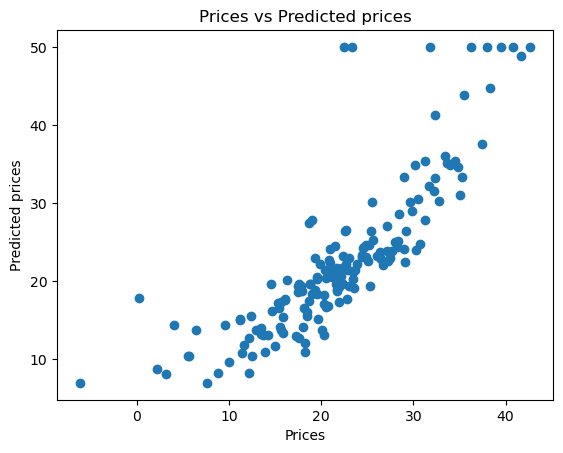

In [ ]:
# Visualizing the differences between actual prices and predicted values
plt.scatter(y_pred_test, y_test)
plt.xlabel("Prices")
plt.ylabel("Predicted prices")
plt.title("Prices vs Predicted prices")
plt.show()

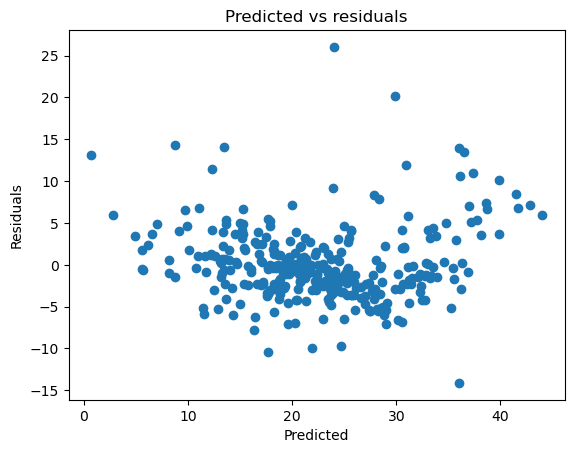

In [ ]:
# Checking residuals
plt.scatter(y_pred_train,y_train-y_pred_train)
plt.title("Predicted vs residuals")
plt.xlabel("Predicted")
plt.ylabel("Residuals")
plt.show()

In [ ]:
# Model Evaluation
acc_rs = r2score(y_pred_test, y_test)
print('R^2 Score:', r2score (y_pred_test, y_test))
print('Mean Squared Error:', mse (y_pred_test, y_test))

R^2 Score: 0.6958654216206024
Mean Squared Error: 28.51074855660067


array([ 0.38921245, -0.49876333])


### 3D Visualization

In [ ]:
from sklearn import preprocessing

# Choosing "RM" and "LSTAT" for animation
xs = np.c_[df['RM'],df['LSTAT']]
ys = df['PRICE']

xs = preprocessing.scale(xs)
ys = preprocessing.scale(ys)

# Single Array
x_RM = preprocessing.scale(df['RM'])
x_LSTAT = preprocessing.scale(df['LSTAT'])

In [ ]:
# Initial weights + bias
w = np.random.randn(xs.shape[1])
b = 0

weights, bias, costs = gradient_descent_function(xs, ys, w, b, iteration=2500);

In [ ]:
print ("Coefficient with Size of Rooms: " , weights[0])
print ("Coefficient with Low status population: " , weights[1])

Coefficient with Size of Rooms:  0.3892796001841946
Coefficient with Low status population:  -0.49869618865486026


In [ ]:
# Predction with two attributes only
y_predicted = bias + weights[0] * x_RM + weights[1] * x_LSTAT

#### Animation

In [ ]:
import numpy as np
from matplotlib import pyplot as plt
from matplotlib import animation
from mpl_toolkits.mplot3d import Axes3D


# Create a figure and a 3D Axes
fig = plt.figure(figsize=(12,10))

ax = fig.add_subplot(111, projection="3d")
ax.set_position([0, 0, 0.95, 1])

ax.set_xlabel('Rooms', fontsize = 15)
ax.set_ylabel('Population', fontsize = 15)
ax.set_zlabel('Price', fontsize = 15)

plt.close()

In [ ]:
def init():
    ax.scatter(xs[:,0], xs[:,1], ys, c='C6', marker='o', alpha=0.6) 
    x0, x1 = np.meshgrid(xs[:,0], xs[:,1])
    y_predicted = weights[0] * x0 + weights[1] * x1
    ax.plot_wireframe(x0,x1,y_predicted, rcount=200,ccount=200, linewidth = 0.5,color='C9', alpha=0.5)
    ax.legend(fontsize=15, labels = ['Data points', 'Hyperplane'])
    return fig,

def animate(i):
    ax.view_init(elev=10., azim=i)
    return fig,


# Animate

anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=360, interval=20, blit=True)

# plt.legend(fontsize=15, labels = [''])
anim.save('animation.gif', writer='imagemagick', fps = 30)
plt.close()

MovieWriter imagemagick unavailable; using Pillow instead.



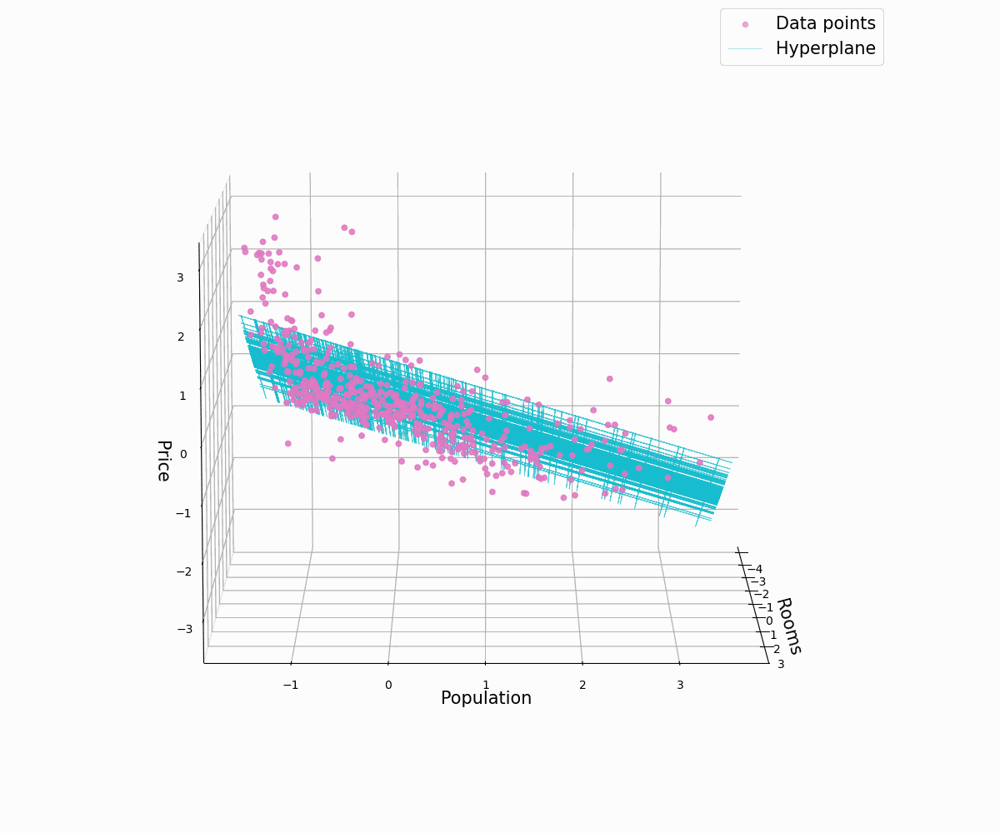

In [ ]:
#Display the animation...
import io
import base64
from IPython.display import HTML

filename = 'animation.gif'

video = io.open(filename, 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<img src="data:image/gif;base64,{0}" type="gif" />'''.format(encoded.decode('ascii')))

## B - Linear Regression from sklearn

#### Splitting into training and test data

In [ ]:
# Spliting target variable and independent variables
X = df.drop(['PRICE'], axis = 1)
y = df['PRICE']

X_train, X_test, y_train, y_test = train_test_split(X,y, test_size = 0.3, random_state = 4)

#### Training the model

In [ ]:
# Import library
from sklearn.linear_model import LinearRegression

# Create a Linear regressor
lm = LinearRegression()

# Train the model
lm.fit(X_train, y_train)

LinearRegression()

In [ ]:
# Intercept
lm.intercept_

36.35704137659499

In [ ]:
# Showing coeffcients
coeffcients = pd.DataFrame([X_train.columns,lm.coef_]).T
coeffcients = coeffcients.rename(columns={0: 'Attribute', 1: 'Coefficients'})
coeffcients

,Attribute,Coefficients
0,CRIM,-0.12257
1,ZN,0.055678
2,INDUS,-0.008834
3,CHAS,4.693448
4,NOX,-14.435783
5,RM,3.28008
6,AGE,-0.003448
7,DIS,-1.552144
8,RAD,0.32625
9,TAX,-0.014067


### Model Evaluation

#### On training data

In [ ]:
y_pred_train = lm.predict(X_train)

In [ ]:
pred_df = pd.DataFrame(
    {
        'Actual Value' : y_train, 
     'Predicted Values' : y_pred_train,
    }
)
pred_df.head(10)

,Actual Value,Predicted Values
84,23.9,24.522480
354,18.2,15.197510
221,21.7,25.577206
34,13.5,13.939400
267,50.0,39.466513
495,23.1,17.459599
262,48.8,39.710299
474,13.8,16.517481
286,20.1,20.197333
162,50.0,40.797755


In [ ]:
# Model Evaluation
print('R^2 Score:', r2score (y_train, y_pred_train))
print('Mean Squared Error:', mse (y_train, y_pred_train))

R^2 Score: 0.6605932547825559
Mean Squared Error: 19.07368870346903


#### On test data

In [ ]:
y_pred_test = lm.predict(X_test)

In [ ]:
pred_df = pd.DataFrame(
    {
        'Actual Value' : y_test, 
     'Predicted Values' : y_pred_test,
    }
)
pred_df.head(10)

,Actual Value,Predicted Values
8,16.5,11.073809
289,24.8,26.479103
68,17.4,17.344899
211,19.3,19.194861
226,37.6,36.361707
70,24.2,24.770958
55,35.4,31.000513
470,19.9,19.942269
409,27.5,19.223751
154,17.0,24.429984


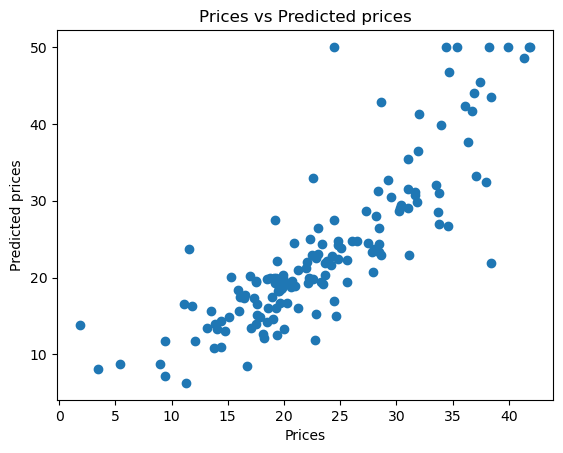

In [ ]:
# Visualizing the differences between actual prices and predicted values
plt.scatter(y_pred_test, y_test)
plt.xlabel("Prices")
plt.ylabel("Predicted prices")
plt.title("Prices vs Predicted prices")
plt.show()

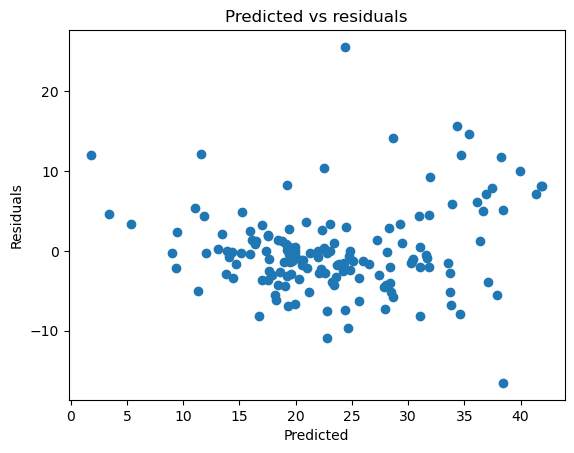

In [ ]:
# Checking residuals
plt.scatter(y_pred_test,y_test-y_pred_test)
plt.title("Predicted vs residuals")
plt.xlabel("Predicted")
plt.ylabel("Residuals")
plt.show()

In [ ]:
# Model Evaluation
acc_linreg = r2score(y_pred_test, y_test)
print('R^2 Score:', r2score (y_test, y_pred_test))
print('Mean Squared Error:', mse (y_test, y_pred_test))

R^2 Score: 0.5377256751904235
Mean Squared Error: 30.053993307124166


## C - XGBoost Regressor

#### Training the model

In [ ]:
# Import XGBoost Regressor
from xgboost import XGBRegressor

#Create a XGBoost Regressor
reg = XGBRegressor()

# Train the model using the training sets 
reg.fit(X_train, y_train)

XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, feature_types=None, gamma=0, gpu_id=-1,
             grow_policy='depthwise', importance_type=None,
             interaction_constraints='', learning_rate=0.300000012, max_bin=256,
             max_cat_threshold=64, max_cat_to_onehot=4, max_delta_step=0,
             max_depth=6, max_leaves=0, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=100, n_jobs=0,
             num_parallel_tree=1, predictor='auto', random_state=0, ...)

### Model Evaluation

#### On training data

In [ ]:
y_pred_train = reg.predict(X_train)

In [ ]:
pred_df = pd.DataFrame(
    {
        'Actual Value' : y_train, 
     'Predicted Values' : y_pred_train,
    }
)
pred_df.head(10)

,Actual Value,Predicted Values
84,23.9,23.898668
354,18.2,18.202156
221,21.7,21.698345
34,13.5,13.493743
267,50.0,49.992077
495,23.1,23.102079
262,48.8,48.794533
474,13.8,13.817799
286,20.1,20.102333
162,50.0,50.001492


#### On test data

In [ ]:
y_pred_test = reg.predict(X_test)

In [ ]:
pred_df = pd.DataFrame(
    {
        'Actual Value' : y_test, 
     'Predicted Values' : y_pred_test,
    }
)
pred_df.head(10)

,Actual Value,Predicted Values
8,16.5,15.788006
289,24.8,22.768932
68,17.4,19.211243
211,19.3,15.688200
226,37.6,48.577423
70,24.2,24.281820
55,35.4,35.454006
470,19.9,19.844229
409,27.5,14.513860
154,17.0,17.764252


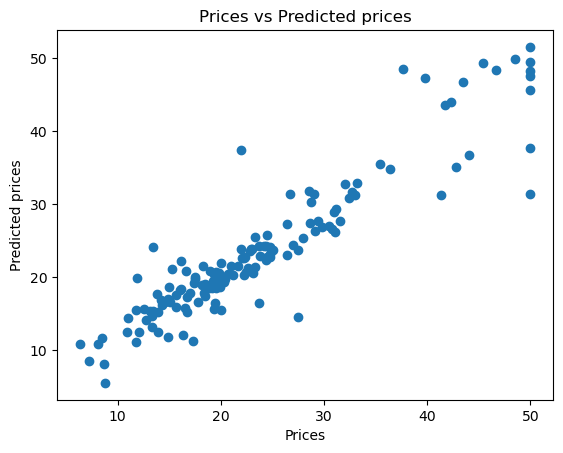

In [ ]:
# Visualizing the differences between actual prices and predicted values
plt.scatter(y_test, y_pred_test)
plt.xlabel("Prices")
plt.ylabel("Predicted prices")
plt.title("Prices vs Predicted prices")
plt.show()

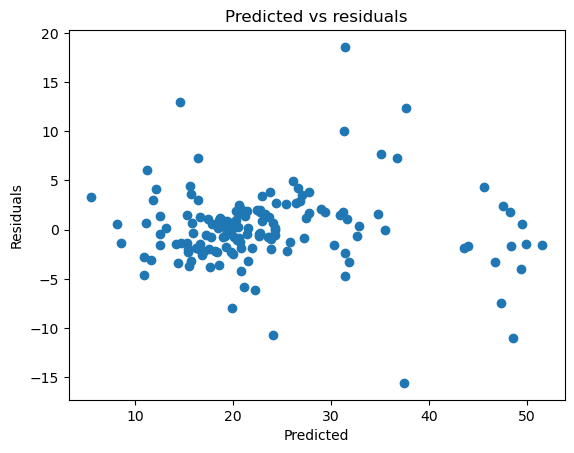

In [ ]:
# Checking residuals
plt.scatter(y_pred_test,y_test-y_pred_test)
plt.title("Predicted vs residuals")
plt.xlabel("Predicted")
plt.ylabel("Residuals")
plt.show()

In [ ]:
# Model Evaluation
acc_xgb = r2score (y_test, y_pred_test)
print('R^2 Score:', acc_xgb)
print('Mean Squared Error:', mse (y_test, y_pred_test))

R^2 Score: 0.839390278103989
Mean Squared Error: 14.828151619536392


## D - Support Vector Machines

In [ ]:
# Creating scaled set to be used in model to improve our results
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

#### Train the model

In [ ]:
# Import SVM Regressor
from sklearn import svm

# Create a SVM Regressor
reg = svm.SVR()

In [ ]:
# Train the model using the training sets 
reg.fit(X_train, y_train)

SVR()

#### Model Evaluation

In [ ]:
# Model prediction on train data
y_pred = reg.predict(X_train)

In [ ]:
# Model Evaluation
print('R^2:',metrics.r2_score(y_train, y_pred))
print('MSE:',metrics.mean_squared_error(y_train, y_pred))

R^2: 0.6419097248941197
MSE: 26.95375210133292


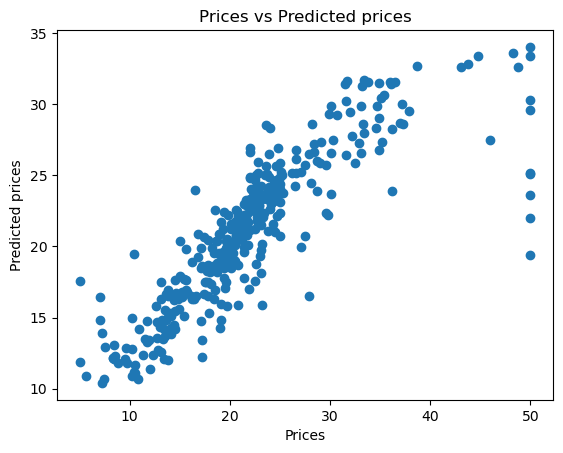

In [ ]:
# Visualizing the differences between actual prices and predicted values
plt.scatter(y_train, y_pred)
plt.xlabel("Prices")
plt.ylabel("Predicted prices")
plt.title("Prices vs Predicted prices")
plt.show()

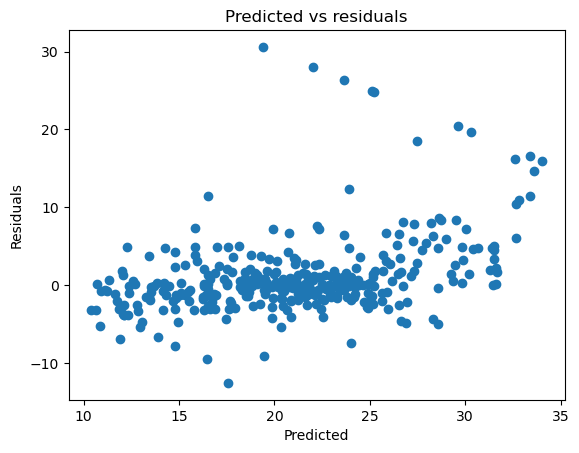

In [ ]:
# Checking residuals
plt.scatter(y_pred,y_train-y_pred)
plt.title("Predicted vs residuals")
plt.xlabel("Predicted")
plt.ylabel("Residuals")
plt.show()

#### For test data

In [ ]:
# Predicting Test data with the model
y_test_pred = reg.predict(X_test)

In [ ]:
# Model Evaluation
acc_svm = metrics.r2_score(y_test, y_test_pred)
print('R^2:', acc_svm)
print('MSE:',metrics.mean_squared_error(y_test, y_test_pred))

R^2: 0.5900158460478178
MSE: 42.81057499010244


# 3. Evaluation and comparision of all the models

In [ ]:
models = pd.DataFrame({
    'Model': ["Regression from scratch" ,'scikit Regression', 'XGBoost', 'Support Vector Machines'],
    'R-squared Score': [acc_rs*100 ,acc_linreg*100, acc_xgb*100, acc_svm*100]})
models.sort_values(by='R-squared Score', ascending=False)

,Model,R-squared Score
2,XGBoost,83.939028
1,scikit Regression,71.218184
0,Regression from scratch,69.599426
3,Support Vector Machines,59.001585
